In [1]:
import cv2
import numpy as np
import pandas as pd
import seaborn as sns
from scipy import signal
import matplotlib.pyplot as plt
import matplotlib.path as mplPath
from matplotlib.patches import Polygon
from scipy.spatial import distance_matrix
from mpl_toolkits.axes_grid1 import AxesGrid
from scipy.spatial import Voronoi, voronoi_plot_2d

Text(0.5, 1.0, 'Original Frame')

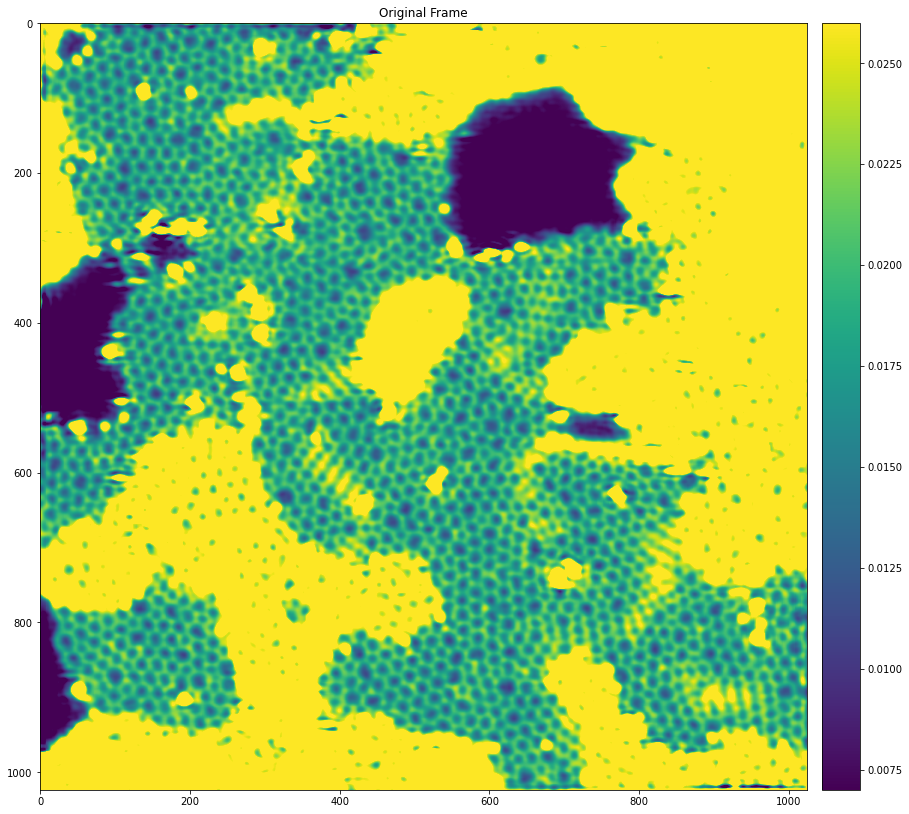

In [2]:
EMImage=np.float32(np.load('denoised.npy'))
fig =plt.figure(1, figsize=(50, 50))
grid=AxesGrid(fig, 236, nrows_ncols=(1,1),
             axes_pad=0.5,
             share_all=False,
             cbar_location="right",
             cbar_mode="each",
             cbar_size="5%",
             cbar_pad="2%")
im=grid[0].imshow(EMImage, cmap=plt.cm.viridis,vmax = 0.026, vmin = 0.007)
grid.cbar_axes[0].colorbar(im)
grid[0].set_title("Original Frame")

In [3]:
#refine the averaged template with pixel precison.
def MatchTemplate(I,template,radius,threshold):
    corr_map = cv2.matchTemplate(I,template,cv2.TM_CCOEFF_NORMED)
    kernel=cv2.getStructuringElement(cv2.MORPH_RECT,(radius, radius))
    dialated_corr= cv2.dilate(corr_map, kernel)
    peak_idx=np.asarray(np.where((corr_map>= dialated_corr)&(corr_map>threshold))).T
    return peak_idx
def RefineTemplate(I,template,radius,threshold):
    peak_idx = MatchTemplate(I,template,radius,threshold)
    point_num = peak_idx.shape[0]
    new_template = np.zeros_like(template)
    for i in range(point_num):
        x_pos = peak_idx[i, 1]
        y_pos = peak_idx[i, 0]
        new_template+= I[y_pos:(y_pos+template.shape[0]), x_pos:(x_pos+template.shape[1])]
    new_template/=point_num
    peak_idx[:,0]+= int(template.shape[0]/2)
    peak_idx[:,1]+= int(template.shape[1]/2)
    return new_template, peak_idx

In [4]:
#detect ring positions
sigma_val = 1.0
gaussian_width = 20
InvImage=np.float32(np.max(EMImage)-EMImage)
t = np.linspace(-gaussian_width, gaussian_width, 2*gaussian_width)
bump = np.exp(-t**2/(2*sigma_val*sigma_val))
bump /= np.trapz(bump) # normalize the integral to 1
template = np.float32(bump[:, np.newaxis] * bump[np.newaxis, :])
template,ring_pos = RefineTemplate(InvImage, template, 4, threshold=-0.4)

Text(0.5, 1.0, 'Original Frame')

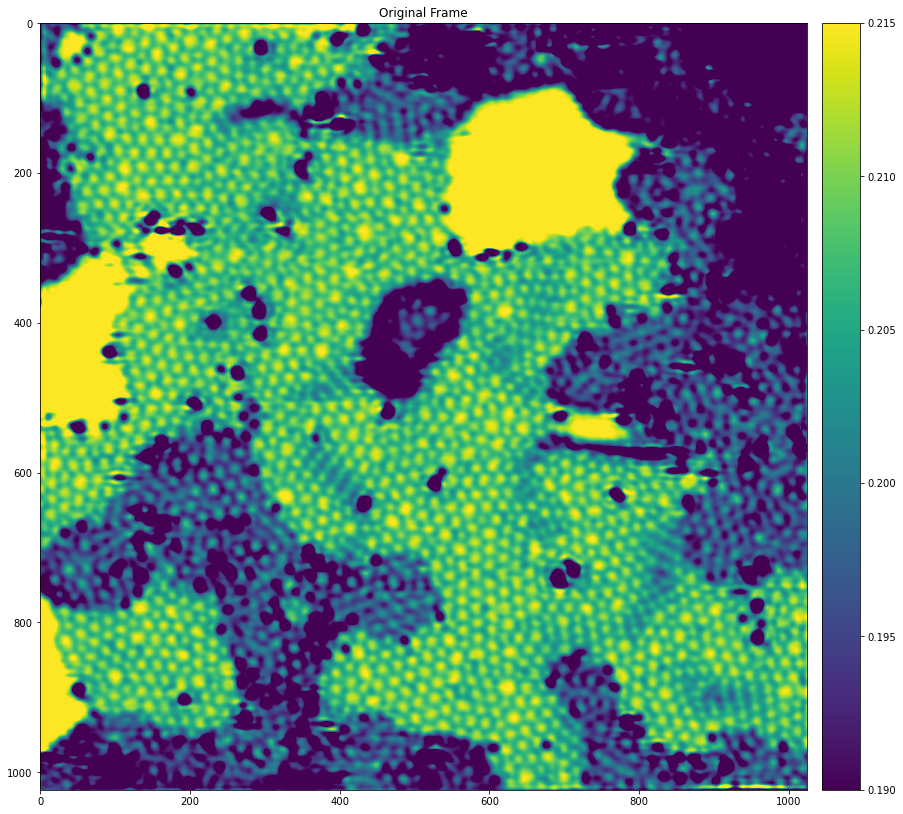

In [18]:
EMImage=np.float32(np.load('denoised.npy'))
fig =plt.figure(1, figsize=(50, 50))
grid=AxesGrid(fig, 236, nrows_ncols=(1,1),
             axes_pad=0.5,
             share_all=False,
             cbar_location="right",
             cbar_mode="each",
             cbar_size="5%",
             cbar_pad="2%")
im=grid[0].imshow(InvImage, cmap=plt.cm.viridis, vmax = 0.215, vmin = 0.19)
grid.cbar_axes[0].colorbar(im)
grid[0].set_title("Original Frame")

In [11]:
#remove the points in the blank area. 
radius = 20
carbon_area = np.zeros_like(EMImage)
carbon_area[np.where(EMImage>0.007)] = 1
kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(radius, radius))
carbon_area = cv2.dilate(carbon_area, kernel)
#filter the detected carbon ring positions.
fring_pos = []
for i in range(ring_pos.shape[0]):
    if(carbon_area[ring_pos[i,0], ring_pos[i,1]]>0):
        fring_pos.append(ring_pos[i])
ring_pos = np.asarray(fring_pos)

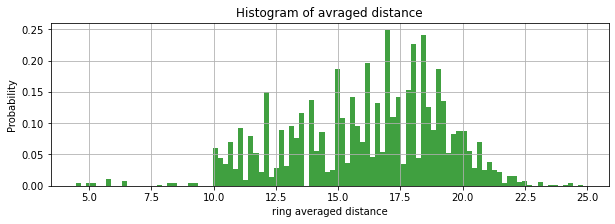

In [14]:
#generate the distance matrix. 
dist_mat = distance_matrix(ring_pos, ring_pos)
for i in range(ring_pos.shape[0]):
    dist_mat[i,i] = 1e10
#generate the averaged distance.
min_dist= np.min(dist_mat, axis=0)
#generate the histogram.
plt.rcParams['figure.figsize'] = (10.0, 3.0)
plt.hist(min_dist, 100, density=True, facecolor='g', alpha=0.75)
plt.xlabel('ring averaged distance')
plt.ylabel('Probability')
plt.title('Histogram of avraged distance')
plt.grid(True)
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


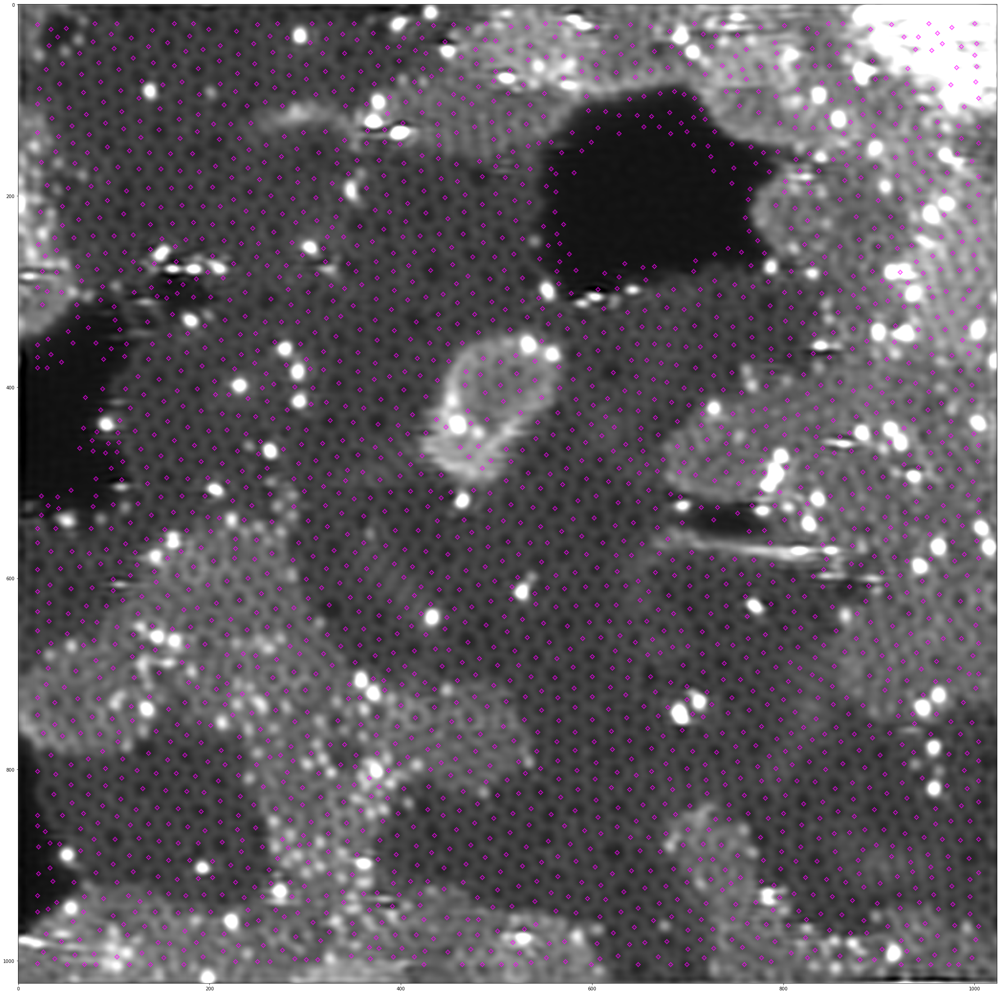

In [15]:
min_thresh = 10
max_thresh = 25
#pick up the rings with relative large distance to nearby rings.
far_idx = np.where((min_dist>=min_thresh)&(min_dist<=max_thresh))
fring_pos = ring_pos[far_idx].copy()
#merge the point pair with a small distance
near_idx = np.where(min_dist<min_thresh)
for i in range(near_idx[0].shape[0]):
    idx1 = near_idx[0][i]
    idx2 = np.argmin(dist_mat[idx1,:])
    if idx2>idx1:
        fring_pos = np.row_stack((fring_pos, ((ring_pos[idx1]+ring_pos[idx2])/2).astype(int)))
ring_pos = fring_pos
#now we replot the image
rgb_frame=cv2.cvtColor(3.0*np.float32(EMImage)/np.float32(np.max(EMImage)), cv2.COLOR_GRAY2BGR)
for i in range(ring_pos.shape[0]):
    cv2.circle(rgb_frame,(ring_pos[i,1],ring_pos[i,0]),2,(255,0,255))
plt.figure(figsize=(40,40))
plt.imshow(rgb_frame)

In [279]:
#remove the ring position.
point = np.array([[350, 280],])
dist_array = distance_matrix(ring_pos, point)
matched_idx = np.where(dist_array<=20.0)[0]
mring_pos = np.delete(ring_pos, matched_idx, 0)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


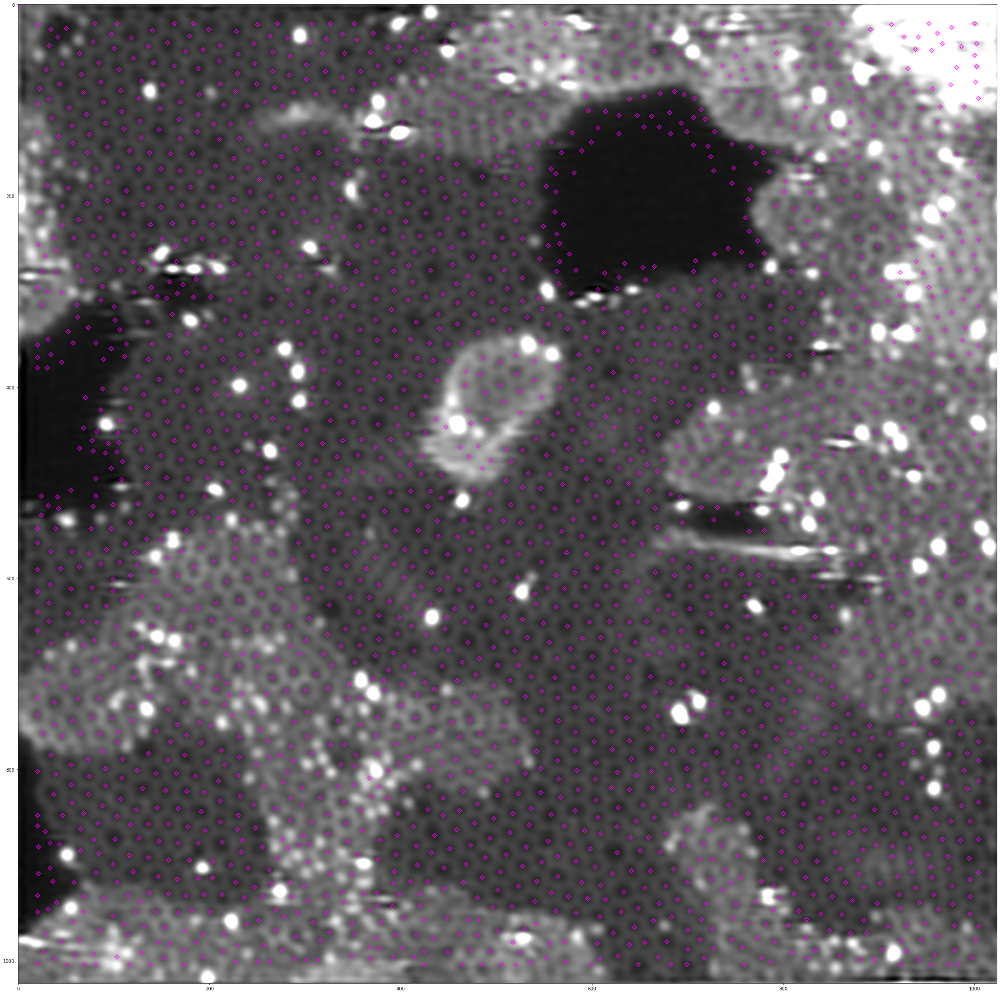

In [16]:
#manually modify the ring position.
voro_pos = np.concatenate((ring_pos, np.array([[0, 0],])))
voro_pos = np.roll(voro_pos, 1, axis= 1)
rgb_frame=cv2.cvtColor(3.0*np.float32(EMImage)/np.float32(np.max(EMImage)), cv2.COLOR_GRAY2BGR)
for i in range(voro_pos.shape[0]):
    cv2.circle(rgb_frame,(voro_pos[i,0],voro_pos[i,1]),2,(255,0,255))
plt.figure(figsize=(40,40))
plt.imshow(rgb_frame)

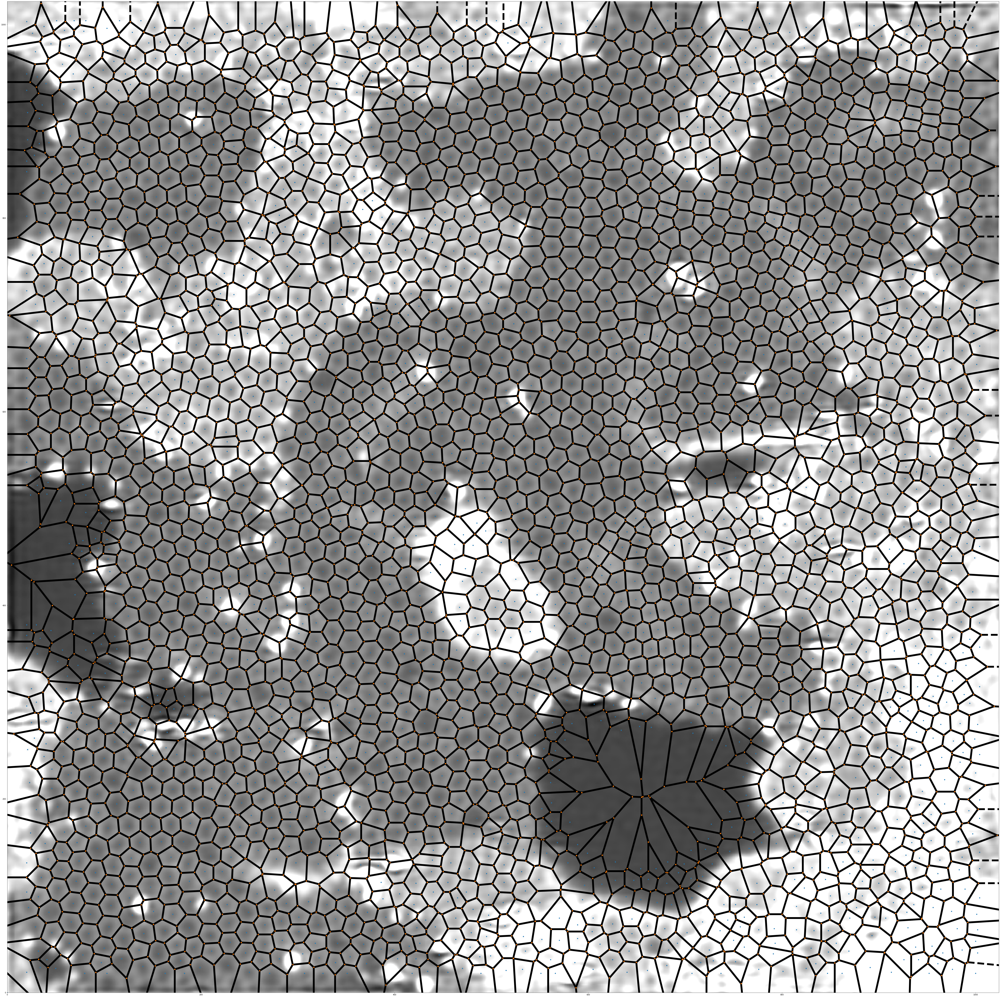

In [17]:
#determine the ring symmetry via voronoi region separation of surrouding hole
vor = Voronoi(voro_pos)
plt.rcParams["figure.figsize"] = (100,100)
fig1, ax1 = plt.subplots()
plt.imshow(EMImage, cmap=plt.cm.gray, vmax =0.04)
voronoi_plot_2d(vor, ax= ax1, show_points=True, show_vertices=True,line_width=10, point_size=10)
plt.xlim((0, EMImage.shape[1]))
plt.ylim((0, EMImage.shape[0]))
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


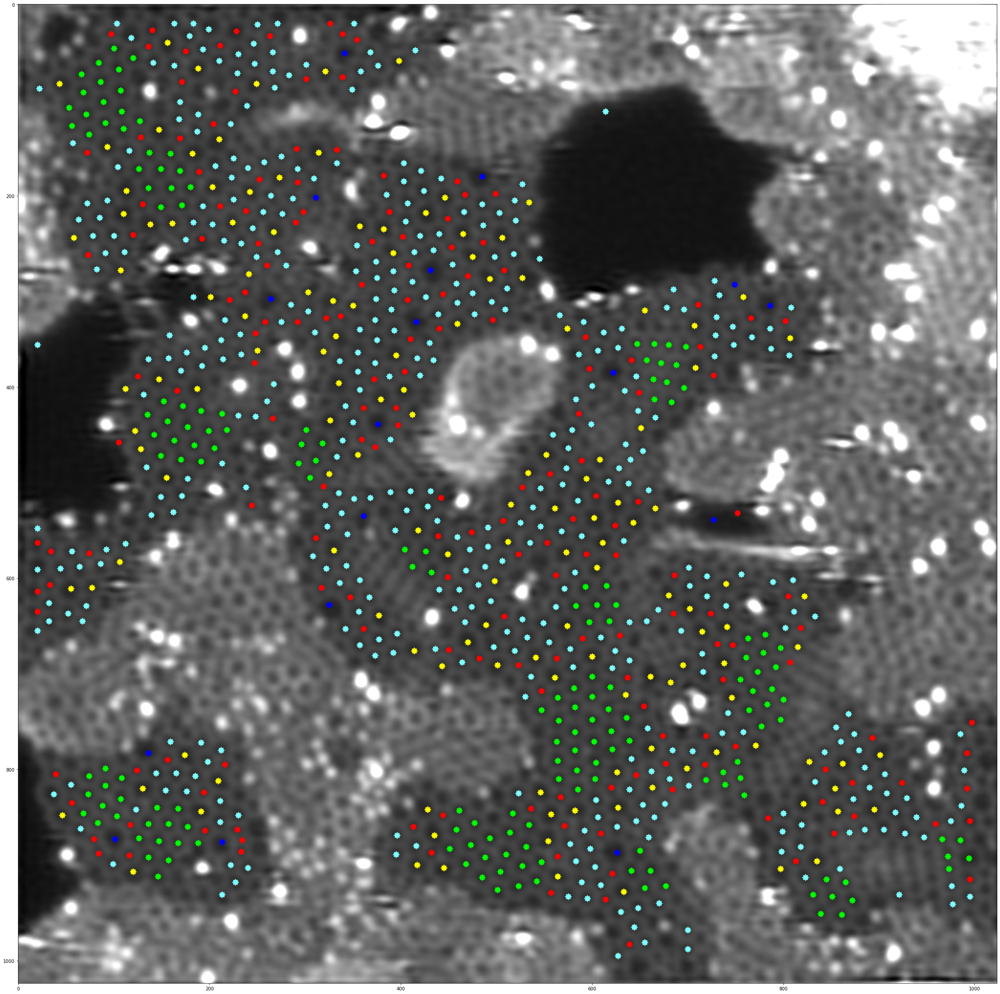

In [19]:
box = 10
bound = 20
fring_pos= []
ring_type = []
max_threshold = 0.025
min_threshold = 0.007
cyrstal_ring = np.zeros(voro_pos.shape[0], np.int8)
rgb_frame=cv2.cvtColor(3.0*np.float32(EMImage)/np.float32(np.max(EMImage)), cv2.COLOR_GRAY2BGR)
#filter the polygons
for p1, region in enumerate(vor.point_region):
    # select the finite region
    if region<0:
        continue
    x_pos = voro_pos[p1,0]
    y_pos = voro_pos[p1,1]
    vertices = vor.regions[region]
    #determine the type of the regions.
    if all(v >= 0 for v in vertices):
        #filter the ring by intensity
        if x_pos < bound: 
            continue
        if y_pos < bound: 
            continue
        if x_pos > EMImage.shape[1]-bound: 
            continue
        if y_pos > EMImage.shape[0]-bound: 
            continue
        sub_image = EMImage[y_pos-box:y_pos+box,x_pos-box:x_pos+box]
        if (np.max(sub_image)>max_threshold):
            continue
        if (np.min(sub_image)<min_threshold):
            continue
        fring_pos.append(voro_pos[p1])
        #determine the region type
        if(len(vertices)==5):
            cv2.circle(rgb_frame,(x_pos,y_pos),3,(1,0,0),thickness=-1)
        if(len(vertices)==6):
            #acquire the index of nearby index of the region.
            nearby_points = [] 
            for i in range(vor.ridge_points.shape[0]):
                if(vor.ridge_points[i,0]==p1):
                    nearby_points.append(vor.ridge_points[i,1])
                if(vor.ridge_points[i,1]==p1):
                    nearby_points.append(vor.ridge_points[i,0])
            nearby_regions = vor.point_region[nearby_points]
            #check if all of the nearby region has 6-fold symmetry
            is_crystal = 0
            for i in range(nearby_regions.shape[0]):
                symm = vor.regions[nearby_regions[i]]
                if(len(symm)!=6):
                    is_crystal = 1
                    break
            #modify the crystallinity
            if is_crystal == 0:
                cyrstal_ring[p1] = 1
                cyrstal_ring[nearby_points] = 1
            else:
                cv2.circle(rgb_frame,(x_pos,y_pos),3,(0.5,1,1),thickness=-1)
        if(len(vertices)==7):
            cv2.circle(rgb_frame,(x_pos,y_pos),3,(1,1,0),thickness=-1)
        if(len(vertices)==8):
            cv2.circle(rgb_frame,(x_pos,y_pos),3,(0,0,1),thickness=-1)
        if(len(vertices)==9):
            cv2.circle(rgb_frame,(x_pos,y_pos),3,(1,1,1),thickness=-1)
        if(len(vertices)>4):
            ring_type.append(len(vertices))
#plot the 6-fold ring regions.
crystal_regions = np.zeros_like(EMImage)
for p1, types in enumerate(cyrstal_ring):
    if types ==1:
        x_pos = voro_pos[p1,0]
        y_pos = voro_pos[p1,1]
        sub_image = EMImage[y_pos-box:y_pos+box,x_pos-box:x_pos+box]
        if (np.max(sub_image)>max_threshold):
            continue
        if (np.min(sub_image)<min_threshold):
            continue
        cv2.circle(rgb_frame,(x_pos,y_pos),3,(0,1,0),thickness=-1)
        #mark the pixels inside this region.
        vertices = vor.vertices[vor.regions[vor.point_region[p1]]]
        path = mplPath.Path(vertices)
        #regions around the path
        subx_min = int(np.floor(np.min(vertices[:,0])))
        subx_max = int(np.ceil(np.max(vertices[:,0])))
        suby_min = int(np.floor(np.min(vertices[:,1])))
        suby_max = int(np.ceil(np.max(vertices[:,1])))
        if subx_min< 0:
            subx_min =0
        if suby_min< 0:
            suby_min =0
        if subx_max> EMImage.shape[1]:
            subx_max = EMImage.shape[1]
        if suby_max> EMImage.shape[0]:
            suby_max = EMImage.shape[0]
        X, Y = np.meshgrid(np.arange(subx_min,subx_max), np.arange(suby_min, suby_max))
        rect_points = np.vstack((X.flatten(), Y.flatten())).T
        valid_pts = rect_points[np.where(path.contains_points(rect_points))]
        crystal_regions[valid_pts[:, 1],valid_pts[:, 0]] = 1.0
ring_type=np.asarray(ring_type)
fring_pos = np.asarray(fring_pos)
fring_pos= np.roll(fring_pos, 1, axis=1)
plt.figure(figsize=(40,40))
plt.imshow(rgb_frame)

<ipython-input-20-34de9c4b4aab>:12: MatplotlibDeprecationWarning: Since 3.2, mpl_toolkits's own colorbar implementation is deprecated; it will be removed two minor releases later.  Set the 'mpl_toolkits.legacy_colorbar' rcParam to False to use Matplotlib's default colorbar implementation and suppress this deprecation warning.
  grid.cbar_axes[0].colorbar(im)


Text(0.5, 1.0, 'crystal regions')

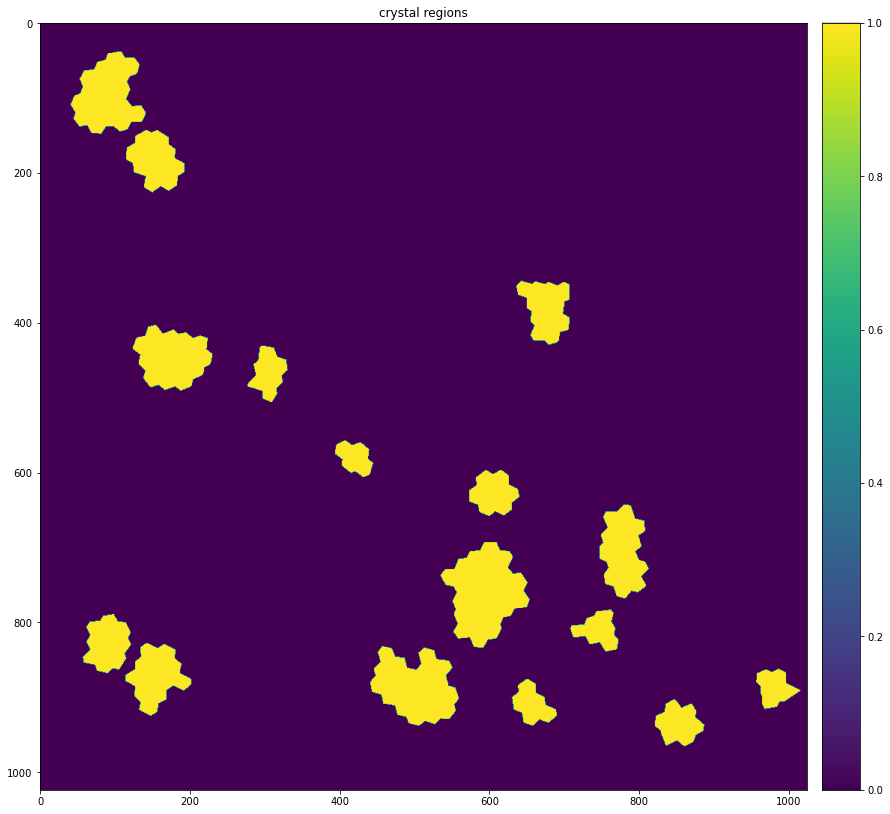

In [20]:
kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(2, 2))
crystal_regions = cv2.dilate(crystal_regions, kernel)
fig =plt.figure(1, figsize=(50, 50))
grid=AxesGrid(fig, 236, nrows_ncols=(1,1),
             axes_pad=0.5,
             share_all=False,
             cbar_location="right",
             cbar_mode="each",
             cbar_size="5%",
             cbar_pad="2%")
im=grid[0].imshow(crystal_regions)
grid.cbar_axes[0].colorbar(im)
grid[0].set_title("crystal regions")

In [21]:
np.save("crystal_region.npy", crystal_regions)

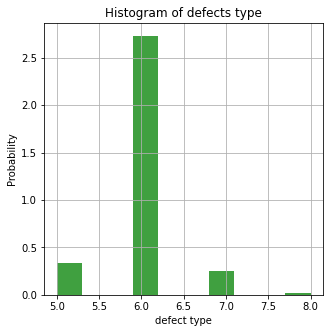

In [351]:
#simple statistics of the ring types
plt.rcParams['figure.figsize'] = (5.0, 5.0)
plt.hist(ring_type, density=True, facecolor='g', alpha=0.75)
plt.title('Histogram of defects type')
plt.xlabel('defect type')
plt.ylabel('Probability')
plt.grid(True)
plt.show()

In [352]:
radius = 50
valid_area = np.zeros_like(EMImage)
valid_area[fring_pos[:,0], fring_pos[:,1]] = 1.0
kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(radius, radius))
valid_area= cv2.dilate(valid_area, kernel)
#selet the vertices inside the valid area and plot them.
carbon_pos = []
for idx, iverti in enumerate(vor.vertices):
    if idx<0:
        continue
    if (iverti[1]<0)|(iverti[0]<0):
        continue
    if (iverti[1]>(EMImage.shape[0]-1))|(iverti[0]>(EMImage.shape[1]-1)):
        continue
    if(valid_area[int(iverti[1]), int(iverti[0])]>0.5):
        carbon_pos.append(iverti)
carbon_pos = np.int32(np.asarray(carbon_pos))
carbon_pos = np.roll(carbon_pos, 1, axis=1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


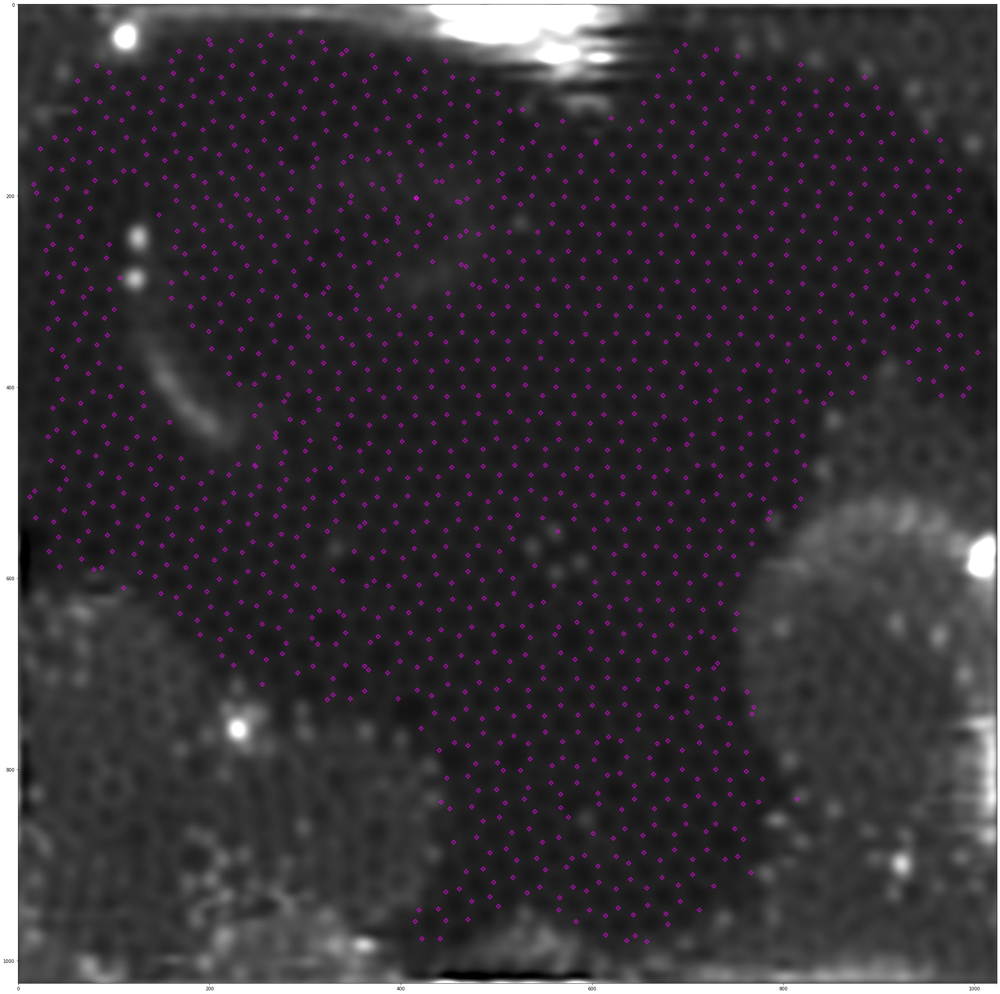

In [353]:
#now we replot the image
rgb_frame=cv2.cvtColor(3.0*np.float32(EMImage)/np.float32(np.max(EMImage)), cv2.COLOR_GRAY2BGR)
for i in range(carbon_pos.shape[0]):
    cv2.circle(rgb_frame,(carbon_pos[i,1],carbon_pos[i,0]),2,(255,0,255))
plt.figure(figsize=(40,40))
plt.imshow(rgb_frame)

In [354]:
np.save("ring_pos.npy", fring_pos)
#np.save("carbon_pos.npy", carbon_pos)